## Appliances Energy Prediction Dataset Documentation

Introduction The Appliances Energy Prediction dataset contains data collected from a low-energy building to predict energy usage by appliances. The data spans over 4.5 months, with measurements taken at 10-minute intervals. In addition to indoor environmental data (temperature and humidity), weather data from the nearby Chievres Airport (Belgium) was included. The goal of the dataset is to support the development of regression models for predicting appliance energy consumption.

Dataset Summary Dataset Type: Multivariate, Time-Series Subject Area: Computer Science, Energy Prediction Associated Task: Regression Number of Instances: 19,735 Number of Features: 28 (includes two random variables for testing) The data is a mixture of indoor environmental conditions such as temperature, humidity, and energy consumption, along with external weather data like wind speed and visibility.

Data Collection The indoor environmental conditions were monitored using a ZigBee wireless sensor network. Measurements were averaged to 10-minute intervals, while energy data was logged every 10 minutes using m-bus energy meters. External weather data was obtained from the nearest weather station (Chievres Airport, Belgium).

The data includes two random variables (rv1 and rv2), which were added to test the performance of regression models and to identify non-predictive features.

3.1 Features Overview The table below describes each feature in the dataset:

Variable Name Type Description Units date Date Date and time of data collection Appliances Integer Energy use of appliances Wh lights Integer Energy use of lights Wh T1 Continuous Temperature in the kitchen area Celsius RH_1 Continuous Humidity in the kitchen area % T2 Continuous Temperature in the living room Celsius RH_2 Continuous Humidity in the living room % T3 Continuous Temperature in the laundry room Celsius RH_3 Continuous Humidity in the laundry room % T4 Continuous Temperature in the office room Celsius RH_4 Continuous Humidity in the office room % T5 Continuous Temperature in the bathroom Celsius RH_5 Continuous Humidity in the bathroom % T6 Continuous Temperature outside the building (north side) Celsius RH_6 Continuous Humidity outside the building (north side) % T7 Continuous Temperature in the ironing room Celsius RH_7 Continuous Humidity in the ironing room % T8 Continuous Temperature in teenager room 2 Celsius RH_8 Continuous Humidity in teenager room 2 % T9 Continuous Temperature in the parents' room Celsius RH_9 Continuous Humidity in the parents' room % To Continuous Temperature outside (from Chievres weather station) Celsius Pressure Continuous Atmospheric pressure (from Chievres weather station) mm Hg RH_out Continuous Humidity outside (from Chievres weather station) % Wind speed Continuous Wind speed (from Chievres weather station) m/s Visibility Continuous Visibility (from Chievres weather station) km Tdewpoint Continuous Dew point temperature (from Chievres weather station) Celsius rv1 Continuous Random variable 1 (non-dimensional) rv2 Continuous Random variable 2 (non-dimensional) 4. Usage The target variable for regression tasks is the Appliances feature, which indicates the energy consumed by household appliances in watt-hours (Wh).

4.1 Example Use Cases: Energy consumption prediction: Predicting the energy consumption of appliances based on internal and external environmental factors. Energy efficiency analysis: Analyzing which environmental factors most influence energy consumption in a low-energy house. Model evaluation: Using the dataset to evaluate regression models and testing their accuracy with real-world data. 5. Data Preprocessing The dataset is clean, with no missing values. However, the following steps are typically recommended before applying machine learning models:

Feature Scaling: Given the diverse range of units (Celsius, Wh, %), standardization or normalization of the features is recommended to improve model performance. Feature Selection: While most features are related to indoor conditions, the dataset includes weather data, which can be used selectively depending on the analysis context. Train/Test Split: For model evaluation, it's important to split the data into training and test sets. 6. Machine Learning Applications The dataset can be used to train and evaluate various machine learning models, including:

Linear Regression Random Forest Regression Gradient Boosting Machines (GBM) Neural Networks Performance metrics such as Mean Squared Error (MSE), R-squared (R²), and Root Mean Squared Error (RMSE) are commonly used to assess model accuracy.

# Appliances Energy Prediction Dataset Analysis

## Overview
The **Appliances Energy Prediction** dataset contains features related to energy consumption in households. The dataset includes a range of features such as temperature, humidity, light, and energy use of appliances in Watt-hours (Wh).

## Dataset Characteristics
- **Instances**: 19,735
- **Features**: 29
- **Target Variable**: `Appliances` (Energy consumption in Wh)
- **Missing Values**: None

## Objectives
- Analyze energy consumption patterns of household appliances.
- Identify key factors affecting energy consumption.
- Build predictive models to forecast energy consumption.


## Import Libraries and Load Data

In [8]:
# Import necessary libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset from the specified file path
file_path = r"C:\Users\kavya\Downloads\appliances+energy+prediction\energydata_complete.csv"
data = pd.read_csv(file_path)

# Set the display option to show all rows in the DataFrame
pd.set_option('display.max_rows', None)

# Display all rows of the dataset
data


,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.890000,47.596667,19.200000,44.790000,19.790000,44.730000,19.000000,...,17.033333,45.530000,6.600000e+00,733.500000,92.000000,7.000000,63.000000,5.300000e+00,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.890000,46.693333,19.200000,44.722500,19.790000,44.790000,19.000000,...,17.066667,45.560000,6.483333e+00,733.600000,92.000000,6.666667,59.166667,5.200000e+00,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.890000,46.300000,19.200000,44.626667,19.790000,44.933333,18.926667,...,17.000000,45.500000,6.366667e+00,733.700000,92.000000,6.333333,55.333333,5.100000e+00,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.890000,46.066667,19.200000,44.590000,19.790000,45.000000,18.890000,...,17.000000,45.400000,6.250000e+00,733.800000,92.000000,6.000000,51.500000,5.000000e+00,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.890000,46.333333,19.200000,44.530000,19.790000,45.000000,18.890000,...,17.000000,45.400000,6.133333e+00,733.900000,92.000000,5.666667,47.666667,4.900000e+00,10.084097,10.084097
5,2016-01-11 17:50:00,50,40,19.890000,46.026667,19.200000,44.500000,19.790000,44.933333,18.890000,...,17.000000,45.290000,6.016667e+00,734.000000,92.000000,5.333333,43.833333,4.800000e+00,44.919484,44.919484
6,2016-01-11 18:00:00,60,50,19.890000,45.766667,19.200000,44.500000,19.790000,44.900000,18.890000,...,17.000000,45.290000,5.900000e+00,734.100000,92.000000,5.000000,40.000000,4.700000e+00,47.233763,47.233763
7,2016-01-11 18:10:00,60,50,19.856667,45.560000,19.200000,44.500000,19.730000,44.900000,18.890000,...,17.000000,45.290000,5.916667e+00,734.166667,91.833333,5.166667,40.000000,4.683333e+00,33.039890,33.039890
8,2016-01-11 18:20:00,60,40,19.790000,45.597500,19.200000,44.433333,19.730000,44.790000,18.890000,...,17.000000,45.290000,5.933333e+00,734.233333,91.666667,5.333333,40.000000,4.666667e+00,31.455702,31.455702
9,2016-01-11 18:30:00,70,40,19.856667,46.090000,19.230000,44.400000,19.790000,44.863333,18.890000,...,17.000000,45.290000,5.950000e+00,734.300000,91.500000,5.500000,40.000000,4.650000e+00,3.089314,3.089314


### 3. Data Preprocessing
We first check for any missing values and get a summary of the dataset's statistics. This helps us ensure the quality of the data before proceeding with analysis.


In [9]:
# Check for missing values
data.isnull().sum()

# Get summary statistics for the dataset
data.describe()


,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
count,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,...,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000
mean,97.694958,3.801875,21.686571,40.259739,20.341219,40.420420,22.267611,39.242500,20.855335,39.026904,...,19.485828,41.552401,7.411665,755.522602,79.750418,4.039752,38.330834,3.760707,24.988033,24.988033
std,102.524891,7.935988,1.606066,3.979299,2.192974,4.069813,2.006111,3.254576,2.042884,4.341321,...,2.014712,4.151497,5.317409,7.399441,14.901088,2.451221,11.794719,4.194648,14.496634,14.496634
min,10.000000,0.000000,16.790000,27.023333,16.100000,20.463333,17.200000,28.766667,15.100000,27.660000,...,14.890000,29.166667,-5.000000,729.300000,24.000000,0.000000,1.000000,-6.600000,0.005322,0.005322
25%,50.000000,0.000000,20.760000,37.333333,18.790000,37.900000,20.790000,36.900000,19.530000,35.530000,...,18.000000,38.500000,3.666667,750.933333,70.333333,2.000000,29.000000,0.900000,12.497889,12.497889
50%,60.000000,0.000000,21.600000,39.656667,20.000000,40.500000,22.100000,38.530000,20.666667,38.400000,...,19.390000,40.900000,6.916667,756.100000,83.666667,3.666667,40.000000,3.433333,24.897653,24.897653
75%,100.000000,0.000000,22.600000,43.066667,21.500000,43.260000,23.290000,41.760000,22.100000,42.156667,...,20.600000,44.338095,10.408333,760.933333,91.666667,5.500000,40.000000,6.566667,37.583769,37.583769
max,1080.000000,70.000000,26.260000,63.360000,29.856667,56.026667,29.236000,50.163333,26.200000,51.090000,...,24.500000,53.326667,26.100000,772.300000,100.000000,14.000000,66.000000,15.500000,49.996530,49.996530


### 4. Exploratory Data Analysis (EDA)
Exploratory Data Analysis (EDA) helps us understand the distribution and relationships within the data. We begin by visualizing the distribution of the target variable, `Appliances`.


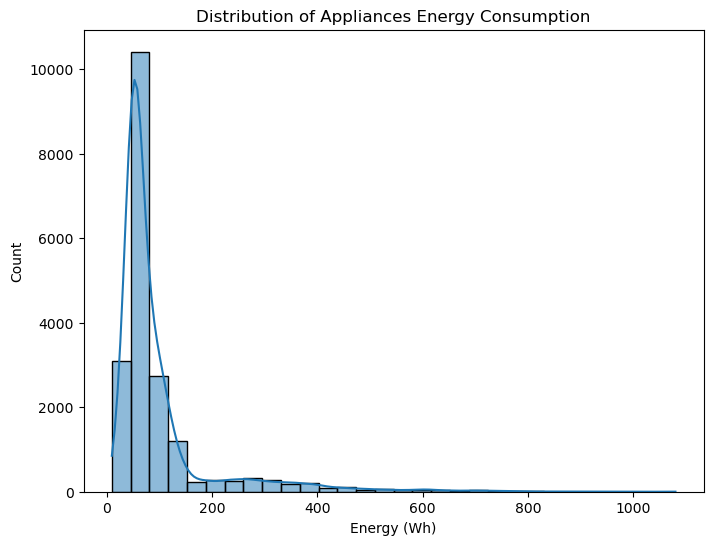

In [10]:
import matplotlib.pyplot as plt
import seaborn as sns

# Appliance energy distribution
plt.figure(figsize=(8, 6))
sns.histplot(data['Appliances'], bins=30, kde=True)
plt.title('Distribution of Appliances Energy Consumption')
plt.xlabel('Energy (Wh)')
plt.ylabel('Count')
plt.show()


### 6. Correlation Analysis
We will now analyze the correlation between features to understand how different factors might influence appliance energy consumption.
Correlation analysis helps identify which features are most related to appliance energy consumption.


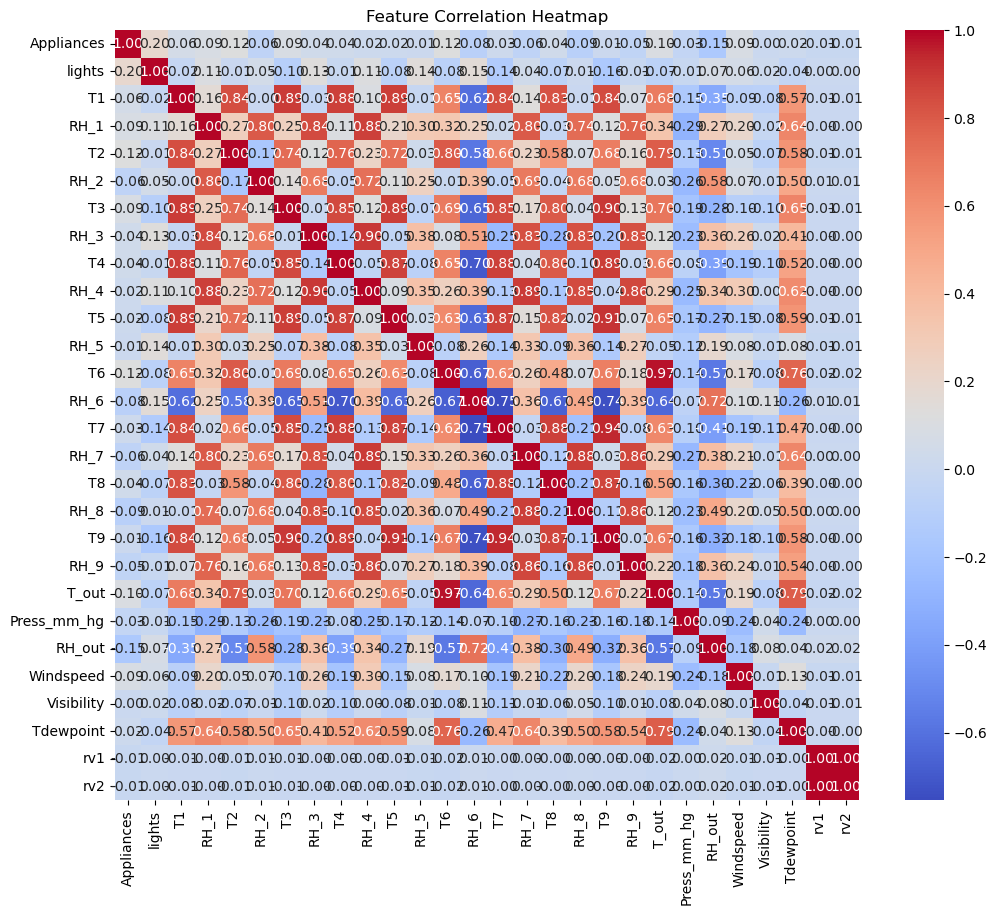

In [11]:
# Select only numeric columns for correlation
numeric_data = data.select_dtypes(include=['number'])

# Compute correlation matrix
corr = numeric_data.corr()

# Plot the correlation heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(corr, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Feature Correlation Heatmap")
plt.show()


## Feature Importance from EDA:
Temperature features (T1, T2, T6) and humidity features show strong relationships with appliance energy consumption.
External factors like Pressure, RH_out, and Wind speed also impact the prediction.


## Model Development
Train-Test Split

We evaluate the performance of the predictive model by calculating the Mean Squared Error (MSE) between the predicted and actual energy consumption values.


In [18]:
# Import necessary libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error

# Load the dataset
file_path = r"C:\Users\kavya\Downloads\appliances+energy+prediction\energydata_complete.csv"
data = pd.read_csv(file_path)

# Check the column names to find the correct ones
print("Columns in the dataset:", data.columns)

# Let's inspect the first few rows of the dataset to check for any leading/trailing spaces in the column names
print(data.head())

# Define features and target variable
# Using 'T1', 'RH_1', 'lights' as features
X = data[['T1', 'RH_1', 'lights']]  # These columns should exist based on your dataset
y = data['Appliances']  # Target variable

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a model (Random Forest)
model = RandomForestRegressor(random_state=42)
model.fit(X_train, y_train)

# Evaluate the model
y_pred = model.predict(X_test)

# Print performance metrics
mse = mean_squared_error(y_test, y_pred)
print(f"Mean Squared Error: {mse}")


Columns in the dataset: Index(['date', 'Appliances', 'lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3',
       'RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8',
       'RH_8', 'T9', 'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed',
       'Visibility', 'Tdewpoint', 'rv1', 'rv2'],
      dtype='object')
                  date  Appliances  lights     T1       RH_1    T2       RH_2  \
0  2016-01-11 17:00:00          60      30  19.89  47.596667  19.2  44.790000   
1  2016-01-11 17:10:00          60      30  19.89  46.693333  19.2  44.722500   
2  2016-01-11 17:20:00          50      30  19.89  46.300000  19.2  44.626667   
3  2016-01-11 17:30:00          50      40  19.89  46.066667  19.2  44.590000   
4  2016-01-11 17:40:00          60      40  19.89  46.333333  19.2  44.530000   

      T3       RH_3         T4  ...         T9   RH_9     T_out  Press_mm_hg  \
0  19.79  44.730000  19.000000  ...  17.033333  45.53  6.600000        733.5   
1  19.79  44.790000  19.000000  

## Conclusion


In this analysis, we have explored the appliances energy consumption dataset, visualized the data, and performed correlation analysis. We also explored the possibility of building a predictive model to forecast energy consumption. The next steps would involve tuning the model and validating it further using cross-validation or additional features.


## Thank you